In [1]:
import os
import sys
import ccdproc
import ccdproc as ccdp
import matplotlib.pyplot as plt
import numpy as np
import fpnfix
import aperturePhot as ap

from astropy import units as u
from astropy.nddata import CCDData
from astropy.visualization import hist
from astropy.stats import mad_std
from ccdproc import ImageFileCollection
from aperturePhot import showimage as show_image 
from pathlib import Path



In [37]:
sys.path.append('/home/idies/workspace/Storage/svhuezo21/persistent/hrpo-pipeline/20201111')

data_dir_base = '/home/idies/workspace'
data_dir = 'Storage/svhuezo21/persistent/hrpo-pipeline/20201111'
data_dir = os.path.join(data_dir_base, data_dir)

#Make a directory to store reduced images
reduced_data = Path(data_dir, 'reduced_images')
reduced_data.mkdir(exist_ok=True)

In [38]:
#Load all of the datafiles
files = ccdp.ImageFileCollection(data_dir)

In [39]:
#Print out summary of data file with selected headers 
files.summary['file', 'imagetyp', 'filter', 'exptime', 'naxis1', 'naxis2']

file,imagetyp,filter,exptime,naxis1,naxis2
str22,str11,object,float64,int64,int64
BL_Lac-001B.fit,Light Frame,Bessel B,60.0,1024,1024
BL_Lac-001R.fit,Light Frame,Bessel R,60.0,1024,1024
BL_Lac-001V.fit,Light Frame,Bessel V,60.0,1024,1024
BL_Lac-002B.fit,Light Frame,Bessel B,60.0,1024,1024
BL_Lac-002R.fit,Light Frame,Bessel R,60.0,1024,1024
BL_Lac-002V.fit,Light Frame,Bessel V,60.0,1024,1024
BL_Lac-003B.fit,Light Frame,Bessel B,60.0,1024,1024
BL_Lac-003R.fit,Light Frame,Bessel R,40.0,1024,1024
BL_Lac-003V.fit,Light Frame,Bessel V,60.0,1024,1024


In [40]:
#Select the calibrated bias images and combine them
calibrated_biases = files.files_filtered(imagetyp='Bias Frame', include_path=True)

combined_bias = ccdp.combine(calibrated_biases,
                             method='median',
                             sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                             sigma_clip_func=np.ma.median, sigma_clip_dev_func=mad_std, unit='adu')

combined_bias.meta['combined'] = True

combined_bias.write(os.path.join(reduced_data / 'combined_bias.fit'), overwrite=True)

In [41]:
#Select the calibrated dark images and combine them
calibrated_darks = files.files_filtered(imagetyp='Dark Frame', include_path=True)
reduced_darks =[]
exptime = []

for frame in calibrated_darks:
    image = ccdp.CCDData.read(frame, unit ='adu')
    exptime.append(image.header["exposure"])
    #Subtract bias from dark image and apend to reduced_darks list
    reduced_darks.append(ccdp.subtract_bias(image,combined_bias))

combined_darks = ccdp.combine(reduced_darks,
                             method='median',
                             sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                             sigma_clip_func=np.ma.median, sigma_clip_dev_func=mad_std, unit='adu', scale = 1 / np.array(exptime) 
                             )

#Scale exposure and exptime to 1
combined_darks.header["exposure"] = 1
combined_darks.header["exptime"] = 1

print(combined_darks.header)

combined_darks.meta['combined'] = True

combined_darks.write(os.path.join(reduced_data / 'combined_darks.fit'), overwrite=True)
    
  

SIMPLE  =                    T                                                  BITPIX  =                   16 /8 unsigned int, 16 & 32 int, -32 & -64 real     NAXIS   =                    2 /number of axes                                  NAXIS1  =                 1024 /fastest changing axis                           NAXIS2  =                 1024 /next to fastest changing axis                   BSCALE  =   1.0000000000000000 /physical = BZERO + BSCALE*array_value           BZERO   =   32768.000000000000 /physical = BZERO + BSCALE*array_value           DATE-OBS= '2020-11-12T00:07:43' /YYYY-MM-DDThh:mm:ss observation start, UT      EXPTIME =                    1 / Exposure time in seconds                       EXPOSURE=                    1 / Exposure time in seconds                       SET-TEMP=  -20.000000000000000 /CCD temperature setpoint in C                   CCD-TEMP=  -19.868483250000001 /CCD temperature at start of exposure in C       XPIXSZ  =   13.000000000000000 /Pixel Wi

In [42]:
images = ccdproc.ImageFileCollection(data_dir)


combfpn = fpnfix.buildFPNFrame(images) #Note this assumes that the SO Darks were taken as 'Light Frame' 
                                       #with OBJECT='SODark' - use imagetyp and object keyword arguments 
                                       #to change this if needed
                                       
#Show the combined FPN frame build from 60 second SO Darks               
ap.showimage(combfpn[60])
#Show the combined FPN frame build from 10 second SO Darks               
ap.showimage(combfpn[10])
                             


FileNotFoundError: [Errno 2] No such file or directory: './reduced/combined_bias.fit'

In [43]:
flat_imagetyp = 'Flat Field'
flat_filters = set(h['filter'] for h in files.headers(imagetyp=flat_imagetyp))
print(flat_filters)

{'Bessel B', 'Bessel V', 'Bessel R'}


In [44]:
#This inverse median function takes all the combined_flats and normalizes them to 1
scale = lambda a: 1/np.median(a)
#Create dictionary to store master_flats
master_flats = {}

#Select the calibrated flat with each filter and combine them

for filt in flat_filters:
    reduced_flats = []
    calibrated_flats = files.files_filtered(imagetyp = flat_imagetyp, filter = filt, include_path=True)
    
    #Select each flat and subtract bias, then subtract darks, then store new image to reduced_flats list   
    for flat in calibrated_flats:
        image = ccdp.CCDData.read(flat, unit = 'adu')
        image = ccdp.subtract_bias(image, combined_bias)
        image = ccdp.subtract_dark(image,combined_darks, scale = True, exposure_unit = u.s, exposure_time = "exptime")
        reduced_flats.append(image)
        
    combined_flats = ccdp.combine(reduced_flats,
                             method='median',
                             sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                             sigma_clip_func=np.ma.median, sigma_clip_dev_func=mad_std, unit='adu', scale = scale 
                             )
   #Make a key for filt in master_flats dictionary and set equal to combined_flats
    master_flats[filt] = combined_flats.copy()
    
    combined_flats.write(reduced_data / (filt.replace(" ","_") + "_combined_flats.fit"), overwrite=True)
    
    

802.2322578430176 2.2239
791.5 812.332852089363


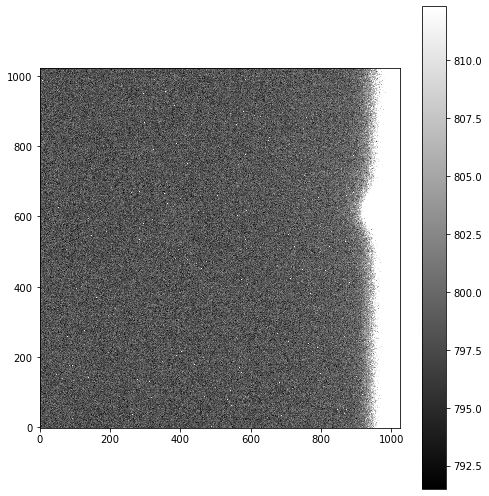

In [45]:
show_image(combined_bias)

0.17338981628417965 0.061775000000000024
-0.26560714112967077 0.6349782684858736


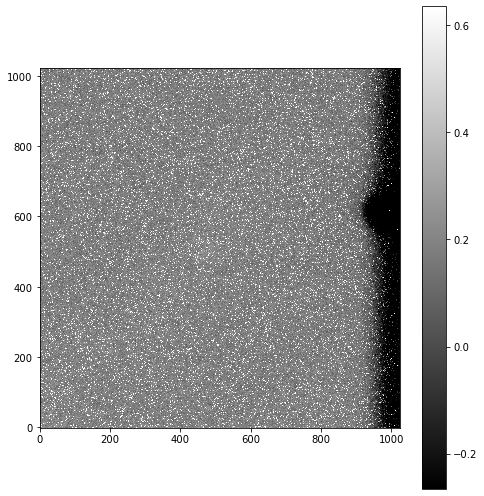

In [46]:
show_image(combined_darks)

0.9998130506345495 0.0065543847774574065
0.969962406832322 1.0197596286526358


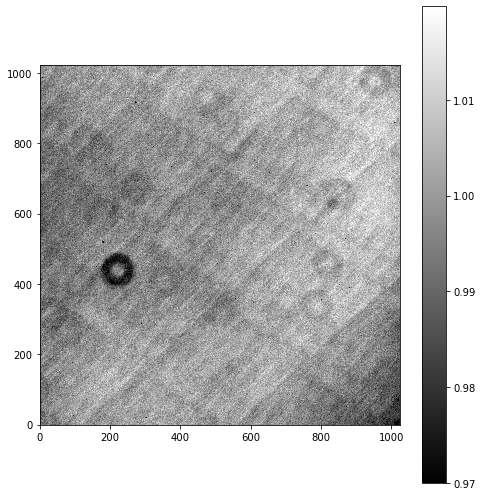

1.000019705184208 0.006542946941222435
0.9700826582208815 1.0218885114898595


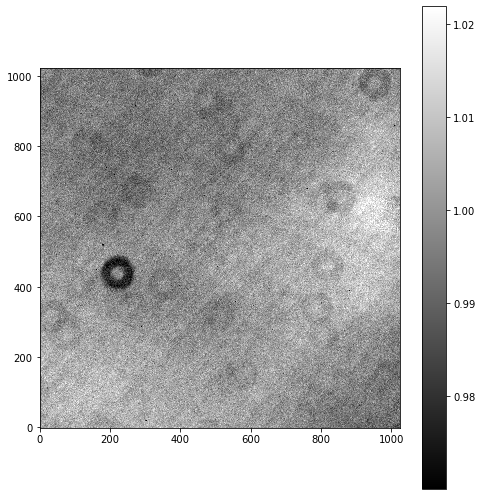

1.0044596382024094 0.010770061684005338
0.9657957999383782 1.0702479837977688


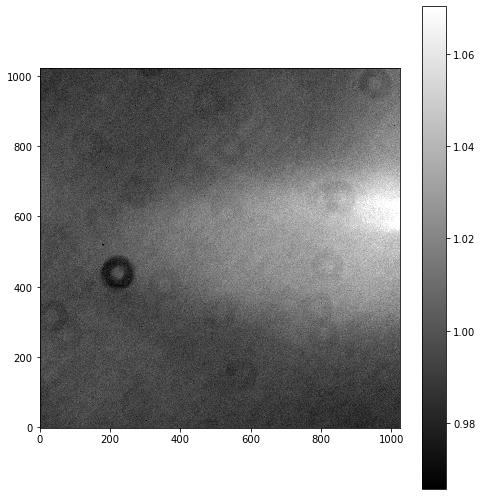

In [47]:
for filt,image in master_flats.items():
    show_image(image)

In [48]:

images = files.files_filtered(imagetyp='Light Frame', include_path=True)
for image in images:
    dim = ccdp.CCDData.read(image, unit = 'adu')
    var_filt = dim.header["filter"]
    
    #Accesses the correct flat by finding the correct filter in the master_flats dictionary
    corr_filt = master_flats[var_filt]
    #This next step is a single basic processing command to process all the image data
    dim = ccdproc.ccd_process(dim,
                           master_bias = combined_bias, dark_frame = combined_darks, master_flat = corr_filt,
                           exposure_key='exposure',
                           exposure_unit=u.second,
                           dark_scale=True,
                          )
    
    proc_data = os.path.basename(image)
    dim.write(reduced_data / ("BDF_" + proc_data), overwrite=True)
    

In [49]:
data = "/home/idies/workspace/Storage/svhuezo21/persistent/hrpo-pipeline/20201111/Barnards_Star-002V.fit"
f = os.path.join(data_dir_base, data)

1125.6680555343628 13.343399999999999
1082 1202.7416257340806


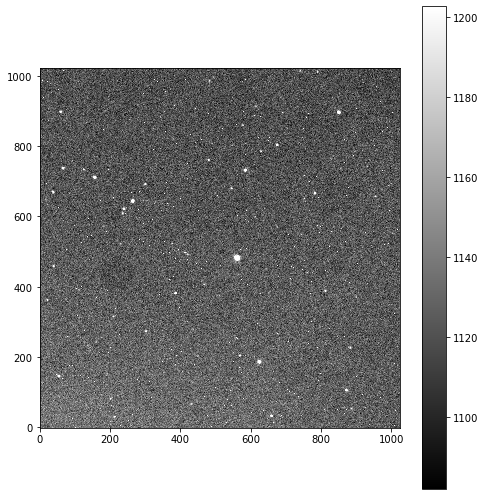

In [50]:
image = ccdp.CCDData.read(f, unit = 'adu')
show_image(image)

In [53]:
#Plate Solving
%matplotlib inline
import sys
sys.path.append('/home/idies/workspace/Storage/svhuezo21/persistent/hrpo-pipeline/')
import plateSolve
from astropy.nddata import CCDData
from astropy.io import fits
import ccdproc
import os
from pathlib import Path
import aperturePhot as ap
import matplotlib.pyplot as plt


datadir = '/home/idies/workspace/Storage/svhuezo21/persistent/hrpo-pipeline/20201111/reduced_images'
path = Path(datadir)
os.chdir(path) #Note the routines have only been tested when run from inside the 
               #directory holding the images.


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
319.98233533806336 13.580068836532979
241.51162296830748 376.4212342783461


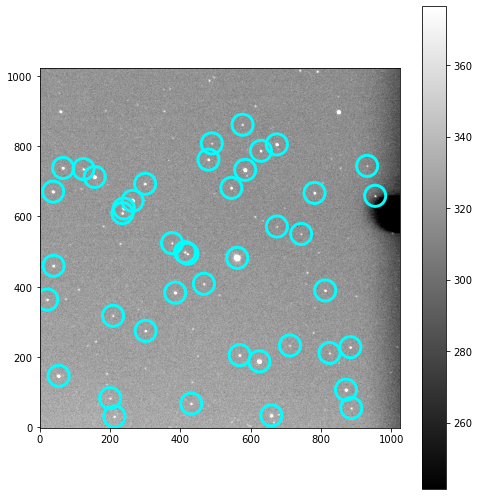

     xcentroid   ycentroid       mag
19  561.529503  482.152784 -5.676780
7   624.326015  187.987584 -3.703456
34  584.054156  732.670542 -2.873564
27  263.693184  644.592792 -2.664733
33  156.066531  712.499583 -2.334164
1   658.644262   33.951860 -2.094235
5   870.927324  107.281756 -2.045973
40  674.261464  805.030096 -2.024337
26  238.997290  622.720918 -1.825747
6    53.469450  146.713708 -1.800940
15  385.114149  383.479412 -1.759802
29  781.444349  667.050639 -1.347865
31  544.773347  681.458429 -1.255707
38  479.619521  761.761670 -1.231139
30   37.770752  670.693962 -1.122834
12  300.872733  274.776312 -1.111711
32  299.555757  692.983153 -1.083550
36   66.068467  738.094538 -1.071058
8   568.603362  205.626071 -1.060128
16  811.789484  389.721765 -0.996176
10  883.299956  228.165905 -0.993794
39  628.867499  786.789361 -0.931423
18   38.964013  459.647699 -0.741237
14   21.043539  363.527417 -0.663332
25  234.986487  609.506512 -0.663230
28  953.916945  658.794823 -0.573475
2

In [61]:
#Use autosolve to find pixel coodinates of CCD image
image_name = 'BDF_Barnards_Star-002V.fit'
imR = CCDData.read(image_name,unit='adu')
check = plateSolve.autoSolve(image_name,imR, verbose=1)
print("Check is True if successful")
print(image_name,check)

['id', 'xcentroid', 'ycentroid', 'sharpness', 'roundness1', 'roundness2', 'npix', 'sky', 'peak', 'flux', 'mag']


/home/idies/workspace/Storage/svhuezo21/persistent/hrpo-pipeline/aperturePhot.py:208: RuntimeWarning: invalid value encountered in sqrt
  errorImage = np.sqrt(data * gain + rn**2)
/home/idies/workspace/Storage/svhuezo21/persistent/hrpo-pipeline/aperturePhot.py:239: RuntimeWarning: invalid value encountered in log10
  mag[i,j] = -2.5*np.log10(f/texp)
/home/idies/workspace/Storage/svhuezo21/persistent/hrpo-pipeline/aperturePhot.py:239: RuntimeWarning: invalid value encountered in log10
  mag[i,j] = -2.5*np.log10(f/texp)
/home/idies/workspace/Storage/svhuezo21/persistent/hrpo-pipeline/aperturePhot.py:239: RuntimeWarning: invalid value encountered in log10
  mag[i,j] = -2.5*np.log10(f/texp)
/home/idies/workspace/Storage/svhuezo21/persistent/hrpo-pipeline/aperturePhot.py:239: RuntimeWarning: invalid value encountered in log10
  mag[i,j] = -2.5*np.log10(f/texp)
/home/idies/workspace/Storage/svhuezo21/persistent/hrpo-pipeline/aperturePhot.py:239: RuntimeWarning: invalid value encountered in l

Star magnitudes at reference aperture radius (3.0):
18 -9.894303044294263
6 -8.004143635934462
36 -7.474859101770786
30 -7.1955469047679355
23 -6.9869461322587725


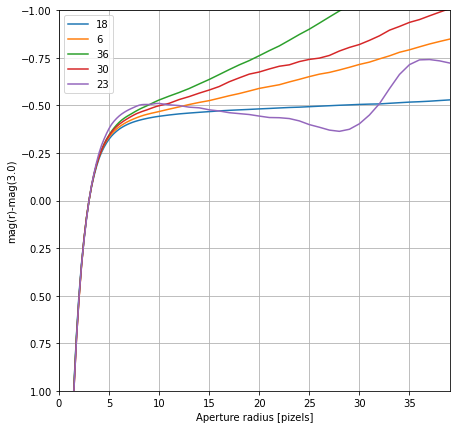

Optimum aperture:
17 3.0
18 5.5
19 3.5


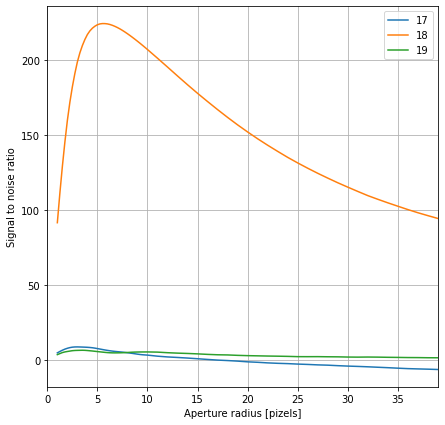

Mean optimum aperture radius = 4.0 from stars [17, 18, 19]
Optimum aperture radius 4.0
stoppingidx 52 26.0
Systematic error from r>stopping aperture
Aperture correction: nan +/- nan


In [62]:
imR = CCDData.read('BDF_Barnards_Star-002V.fit')
#imR = fits.open(path / 'Standard109954-001R_wcs.fit')

#Find stars in the image
sources,bgplane = ap.findStars(imR)

#Generate a growth curve (i.e., measure fluxes at a range of aperture 
#sizes for all stars)
rap,mag,err,apers = ap.growthCurve(imR,sources)

#Plot the growth curve - use this to pick stars to use when calculating 
#the aperture correction
ap.plotGrowth(rap,mag,err,figsize=(7,7))
useForAppCorr = [12]
stoppingApertureRadius = 26.0

#Plot the SNR curve for a chosen star(s) and estimate the optimum aperture
ap.plotSNR(rap,mag,err,Nbrightest=[17,18,19],figsize=(7,7))

#Apply an aperture correction for a chosen optimal aperture radius
imag,ierr,isys,apCorr = ap.apertureCorrection(rap,mag,err,optap=[17,18,19],
                                              stoppingAperture=stoppingApertureRadius,
                                              stars=useForAppCorr)



319.98233533806336 13.580068836532979
241.51162296830748 376.4212342783461
['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38']


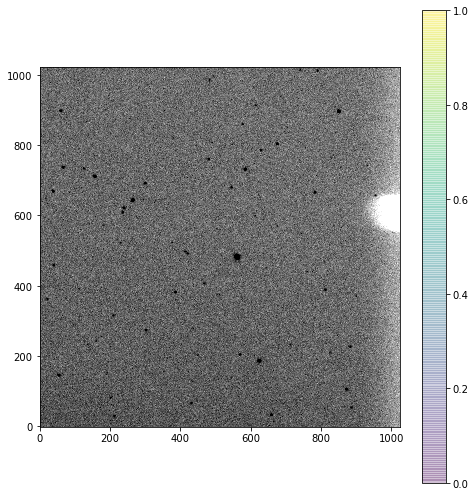

319.98233533806336 13.580068836532979
241.51162296830748 376.4212342783461
['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38']


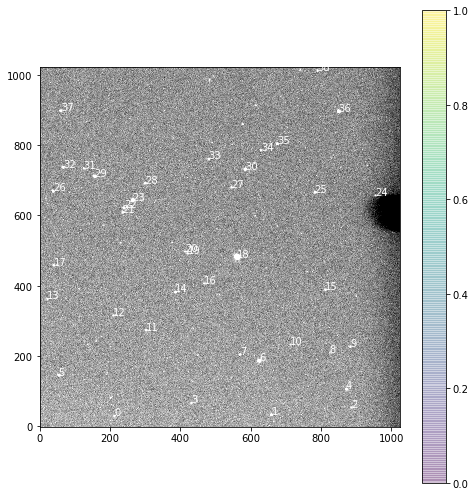

   0     nan +/- 0.157 (stat)   nan (sys)
   1     nan +/- 0.036 (stat)   nan (sys)
   2     nan +/- 0.171 (stat)   nan (sys)
   3     nan +/- 0.143 (stat)   nan (sys)
   4     nan +/- 0.037 (stat)   nan (sys)
   5     nan +/- 0.049 (stat)   nan (sys)
   6     nan +/- 0.012 (stat)   nan (sys)
   7     nan +/- 0.083 (stat)   nan (sys)
   8     nan +/- 0.195 (stat)   nan (sys)
   9     nan +/- 0.100 (stat)   nan (sys)
  10     nan +/- 0.233 (stat)   nan (sys)
  11     nan +/- 0.109 (stat)   nan (sys)
  12     nan +/- 0.210 (stat)   nan (sys)
  13     nan +/- 0.137 (stat)   nan (sys)
  14     nan +/- 0.051 (stat)   nan (sys)
  15     nan +/- 0.097 (stat)   nan (sys)
  16     nan +/- 0.183 (stat)   nan (sys)
  17     nan +/- 0.107 (stat)   nan (sys)
  18     nan +/- 0.004 (stat)   nan (sys)
  19     nan +/- 0.143 (stat)   nan (sys)
  20     nan +/- 0.148 (stat)   nan (sys)
  21     nan +/- 0.118 (stat)   nan (sys)
  22     nan +/- 0.047 (stat)   nan (sys)
  23     nan +/- 0.023 (stat)   na

In [63]:
#Show the image of the tooltip-labeled starfield (hover over stars with the mouse)
ap.showimage(imR,stars=sources,invert=True)

#Or with all stars labeled
ap.showimage(imR,stars=sources,starid='label')

for i,m in enumerate(imag):
    print('%4d %7.3f +/- %5.3f (stat) %5.3f (sys)' % (sources['id'][i]-1,m,ierr[i],isys))

In [64]:
#Repeat the process for another image, but with stars found in the first image

import astropy.wcs as wcs
imR = fits.open('BDF_Barnards_Star-002V.wcs.fit')
wcsR = wcs.WCS(imR.header)
wcsV = wcs.WCS(imV.header)
Rstarxy = np.transpose((sources['xcentroid'],sources['ycentroid']))
radec = wcsR.all_pix2world(Rstarxy,1)
Bstarxy = wcsB.all_world2pix(radec,1)

ap.showimage(imB[0],stars=Bstarxy,starid='label')


#Generate a growth curve (i.e., measure fluxes at a range of aperture 
#sizes for all stars)
rapB,magB,errB,apersB = ap.growthCurve(imB,Bstarxy)

#Apply an aperture correction for a chosen optimal aperture radius
imagB,ierrB,isysB,apCorrB = ap.apertureCorrection(rapB,magB,errB,optap=4.5,
                                              stoppingAperture=stoppingApertureRadius,
                                              stars=useForAppCorr)

for i,m in enumerate(imagB):
    print('%4d %7.3f +/- %5.3f (stat) %5.3f (sys)' % (sources['id'][i]-1,m,ierr[i],isys))

AttributeError: 'HDUList' object has no attribute 'header'